In [1]:
import pandas as pd 
import numpy as np
import matplotlib.pyplot as plt
import os
import glob
import cv2
import subprocess

In [4]:
# the reason for the sharp jump is that the contact material at Interface moved a lot compared to other mateirla sna the DIC was not able to capture it

In [5]:
def infer_plot(file_number: int, output_dir=None, show=True):
    if len(str(file_number)) == 1:
        file_name_txt = f"DIC_Data/Tangential/R1_CAFS13_DICResults/B0000{file_number}.txt"   # Make sure this is .txt file
    elif len(str(file_number)) == 2:
        file_name_txt = f"DIC_Data/Tangential/R1_CAFS13_DICResults/B000{file_number}.txt"   # Make sure this is .txt file
    with open(file_name_txt,'r') as f:
        content = f.readlines()

    df = pd.DataFrame([[float(j) for j in i.split("\t")] for i in content[1:]])
    df = df.rename({0: "X-Position", 1: "Y-Position", 2: "U-Displacement", 3: "V-Displacement"}, axis=1)
        
    # Filter out zero displacement values (masked regions)
    df_filtered = df[(df['U-Displacement'] != 0) & (df['V-Displacement'] != 0)]

    # Create comprehensive plots
    fig, axes = plt.subplots(2, 3, figsize=(18, 12))

    # 1. U-Displacement vs X-Position (Interface Detection)
    axes[0,0].scatter(df_filtered['X-Position'], df_filtered['U-Displacement'], 
                    c='blue', alpha=0.6, s=20)
    axes[0,0].set_xlabel('X-Position (pixels)')
    axes[0,0].set_ylabel('U-Displacement (pixels)')
    axes[0,0].set_title('U-Displacement vs X-Position\n(Interface Detection)')
    axes[0,0].grid(True, alpha=0.3)

    axes[0,0].set_xlim(0, 1300)     
    axes[0,0].set_ylim(-10, 50) 

    # 2. V-Displacement vs X-Position (Critical for Contact Analysis)
    axes[0,1].scatter(df_filtered['X-Position'], df_filtered['V-Displacement'], 
                    c='red', alpha=0.6, s=20)
    axes[0,1].set_xlabel('X-Position (pixels)')
    axes[0,1].set_ylabel('V-Displacement (pixels)')
    axes[0,1].set_title('V-Displacement vs X-Position\n(Contact Interface)')
    axes[0,1].grid(True, alpha=0.3)
 
    axes[0,1].set_xlim(0, 1300)     
    axes[0,1].set_ylim(-50, 50) 

    # 3. Displacement Field Visualization
    scatter = axes[0,2].scatter(df_filtered['X-Position'], df_filtered['Y-Position'], 
                            c=df_filtered['U-Displacement'], cmap='viridis', s=50, vmin=-50, vmax=50)
    axes[0,2].set_xlabel('X-Position (pixels)')
    axes[0,2].set_ylabel('Y-Position (pixels)')
    axes[0,2].set_title('U-Displacement Field')
    plt.colorbar(scatter, ax=axes[0,2], label='U-Displacement (pixels)')

    # 4. V-Displacement Field
    scatter2 = axes[1,0].scatter(df_filtered['X-Position'], df_filtered['Y-Position'], 
                                c=df_filtered['V-Displacement'], cmap='plasma', s=50, vmin=-50, vmax=50)
    axes[1,0].set_xlabel('X-Position (pixels)')
    axes[1,0].set_ylabel('Y-Position (pixels)')
    axes[1,0].set_title('V-Displacement Field')
    plt.colorbar(scatter2, ax=axes[1,0], label='V-Displacement (pixels)')

    # 5. Total Displacement Magnitude
    df_filtered['Total_Displacement'] = np.sqrt(df_filtered['U-Displacement']**2 + 
                                            df_filtered['V-Displacement']**2)
    scatter3 = axes[1,1].scatter(df_filtered['X-Position'], df_filtered['Y-Position'], 
                                c=df_filtered['Total_Displacement'], cmap='plasma', s=50, vmin=-50, vmax=50)
    axes[1,1].set_xlabel('X-Position (pixels)')
    axes[1,1].set_ylabel('Y-Position (pixels)')
    axes[1,1].set_title('Total Displacement Magnitude')
    plt.colorbar(scatter3, ax=axes[1,1], label='Total Displacement (pixels)')

    # 6. Cross-sectional Analysis (at specific Y-value)
    y_slice = df_filtered['Y-Position'].iloc[0]  # Take first Y value
    df_slice = df_filtered[df_filtered['Y-Position'] == y_slice]
    axes[1,2].plot(df_slice['X-Position'], df_slice['V-Displacement'], 'ro-', 
                label=f'V-Disp at Y={y_slice}')
    axes[1,2].plot(df_slice['X-Position'], df_slice['U-Displacement'], 'bo-', 
                label=f'U-Disp at Y={y_slice}')
    axes[1,2].set_xlabel('X-Position (pixels)')
    axes[1,2].set_ylabel('Displacement (pixels)')
    axes[1,2].set_title(f'Cross-sectional View at Y={y_slice}')
    axes[1,2].legend()
    axes[1,2].grid(True, alpha=0.3)

    axes[1,2].set_xlim(0, 1300)     
    axes[1,2].set_ylim(-30, 30) 

    fig.suptitle(f"t={file_number}")

    plt.tight_layout()
    
    # SAVE BEFORE SHOWING
    if output_dir is not None:
        os.makedirs(output_dir, exist_ok=True)  # Create directory if it doesn't exist
        filename = os.path.join(output_dir, f"{file_number}.png")
        fig.savefig(filename, dpi=300, bbox_inches='tight', facecolor='white')
        print(f"Plot saved as: {filename}")
    if show:
        plt.show()  # Show after saving

    # Additional Analysis: Interface Detection
    print("Data Summary:")
    print(f"U-Displacement range: {df_filtered['U-Displacement'].min():.3f} to {df_filtered['U-Displacement'].max():.3f}")
    print(f"V-Displacement range: {df_filtered['V-Displacement'].min():.3f} to {df_filtered['V-Displacement'].max():.3f}")
    print(f"Total data points: {len(df_filtered)}")

    # Look for potential interfaces (large displacement gradients)
    df_filtered_sorted = df_filtered.sort_values('X-Position')
    u_gradient = np.gradient(df_filtered_sorted['U-Displacement'])
    v_gradient = np.gradient(df_filtered_sorted['V-Displacement'])

    print(f"\nLargest U-displacement gradients at X-positions:")
    max_u_grad_idx = np.argsort(np.abs(u_gradient))[-3:]
    for idx in max_u_grad_idx:
        x_pos = df_filtered_sorted.iloc[idx]['X-Position']
        grad_val = u_gradient[idx]
        print(f"X = {x_pos:.0f}, gradient = {grad_val:.3f}")


/var/folders/3p/xlr6tgyx4t980qpxnnrs12kc0000gn/T/ipykernel_20544/530358085.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered['Total_Displacement'] = np.sqrt(df_filtered['U-Displacement']**2 +


Plot saved as: Plots_per_timestep_Tangential_Loading/1.png
Data Summary:
U-Displacement range: -0.035 to 0.241
V-Displacement range: -0.002 to 0.260
Total data points: 4798

Largest U-displacement gradients at X-positions:
X = 88, gradient = -0.104
X = 40, gradient = -0.117
X = 8, gradient = 0.202


/var/folders/3p/xlr6tgyx4t980qpxnnrs12kc0000gn/T/ipykernel_20544/530358085.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered['Total_Displacement'] = np.sqrt(df_filtered['U-Displacement']**2 +


Plot saved as: Plots_per_timestep_Tangential_Loading/2.png
Data Summary:
U-Displacement range: -0.457 to 0.392
V-Displacement range: 0.150 to 1.132
Total data points: 4797

Largest U-displacement gradients at X-positions:
X = 104, gradient = 0.336
X = 88, gradient = 0.356
X = 8, gradient = 0.482


/var/folders/3p/xlr6tgyx4t980qpxnnrs12kc0000gn/T/ipykernel_20544/530358085.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered['Total_Displacement'] = np.sqrt(df_filtered['U-Displacement']**2 +


Plot saved as: Plots_per_timestep_Tangential_Loading/3.png
Data Summary:
U-Displacement range: -1.493 to 0.139
V-Displacement range: 0.210 to 1.454
Total data points: 4797

Largest U-displacement gradients at X-positions:
X = 104, gradient = 0.449
X = 88, gradient = -0.507
X = 88, gradient = 0.601


/var/folders/3p/xlr6tgyx4t980qpxnnrs12kc0000gn/T/ipykernel_20544/530358085.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered['Total_Displacement'] = np.sqrt(df_filtered['U-Displacement']**2 +


Plot saved as: Plots_per_timestep_Tangential_Loading/4.png
Data Summary:
U-Displacement range: -1.720 to 1.220
V-Displacement range: 0.123 to 1.961
Total data points: 4797

Largest U-displacement gradients at X-positions:
X = 88, gradient = -0.806
X = 88, gradient = 0.926
X = 8, gradient = -1.127


/var/folders/3p/xlr6tgyx4t980qpxnnrs12kc0000gn/T/ipykernel_20544/530358085.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered['Total_Displacement'] = np.sqrt(df_filtered['U-Displacement']**2 +


Plot saved as: Plots_per_timestep_Tangential_Loading/5.png
Data Summary:
U-Displacement range: -1.918 to 1.343
V-Displacement range: 0.101 to 2.724
Total data points: 4797

Largest U-displacement gradients at X-positions:
X = 24, gradient = 0.773
X = 8, gradient = 1.041
X = 8, gradient = 2.025


/var/folders/3p/xlr6tgyx4t980qpxnnrs12kc0000gn/T/ipykernel_20544/530358085.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered['Total_Displacement'] = np.sqrt(df_filtered['U-Displacement']**2 +


Plot saved as: Plots_per_timestep_Tangential_Loading/6.png
Data Summary:
U-Displacement range: -2.640 to 2.594
V-Displacement range: 0.383 to 3.757
Total data points: 4797

Largest U-displacement gradients at X-positions:
X = 40, gradient = 1.408
X = 40, gradient = -1.440
X = 8, gradient = 2.080


/var/folders/3p/xlr6tgyx4t980qpxnnrs12kc0000gn/T/ipykernel_20544/530358085.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered['Total_Displacement'] = np.sqrt(df_filtered['U-Displacement']**2 +


Plot saved as: Plots_per_timestep_Tangential_Loading/7.png
Data Summary:
U-Displacement range: -3.629 to 2.478
V-Displacement range: 2.885 to 4.252
Total data points: 4797

Largest U-displacement gradients at X-positions:
X = 8, gradient = -1.104
X = 8, gradient = -2.107
X = 8, gradient = 2.129


/var/folders/3p/xlr6tgyx4t980qpxnnrs12kc0000gn/T/ipykernel_20544/530358085.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered['Total_Displacement'] = np.sqrt(df_filtered['U-Displacement']**2 +


Plot saved as: Plots_per_timestep_Tangential_Loading/8.png
Data Summary:
U-Displacement range: -3.538 to 3.879
V-Displacement range: 3.287 to 6.091
Total data points: 4797

Largest U-displacement gradients at X-positions:
X = 8, gradient = 1.834
X = 200, gradient = -1.872
X = 200, gradient = 1.872


/var/folders/3p/xlr6tgyx4t980qpxnnrs12kc0000gn/T/ipykernel_20544/530358085.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered['Total_Displacement'] = np.sqrt(df_filtered['U-Displacement']**2 +


Plot saved as: Plots_per_timestep_Tangential_Loading/9.png
Data Summary:
U-Displacement range: -2.205 to 4.855
V-Displacement range: 4.706 to 7.413
Total data points: 4796

Largest U-displacement gradients at X-positions:
X = 8, gradient = 2.324
X = 56, gradient = -2.327
X = 56, gradient = 2.339


/var/folders/3p/xlr6tgyx4t980qpxnnrs12kc0000gn/T/ipykernel_20544/530358085.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered['Total_Displacement'] = np.sqrt(df_filtered['U-Displacement']**2 +


Plot saved as: Plots_per_timestep_Tangential_Loading/10.png
Data Summary:
U-Displacement range: -4.351 to 4.983
V-Displacement range: 5.799 to 8.685
Total data points: 4795

Largest U-displacement gradients at X-positions:
X = 8, gradient = 2.375
X = 8, gradient = -2.394
X = 8, gradient = 4.604


/var/folders/3p/xlr6tgyx4t980qpxnnrs12kc0000gn/T/ipykernel_20544/530358085.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered['Total_Displacement'] = np.sqrt(df_filtered['U-Displacement']**2 +


Plot saved as: Plots_per_timestep_Tangential_Loading/11.png
Data Summary:
U-Displacement range: -0.534 to 4.199
V-Displacement range: 7.706 to 9.398
Total data points: 4795

Largest U-displacement gradients at X-positions:
X = 72, gradient = 1.860
X = 72, gradient = -2.028
X = 8, gradient = -3.072


/var/folders/3p/xlr6tgyx4t980qpxnnrs12kc0000gn/T/ipykernel_20544/530358085.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered['Total_Displacement'] = np.sqrt(df_filtered['U-Displacement']**2 +


Plot saved as: Plots_per_timestep_Tangential_Loading/12.png
Data Summary:
U-Displacement range: -1.759 to 4.445
V-Displacement range: 8.198 to 10.571
Total data points: 4795

Largest U-displacement gradients at X-positions:
X = 8, gradient = 2.272
X = 8, gradient = -2.312
X = 8, gradient = -3.541


/var/folders/3p/xlr6tgyx4t980qpxnnrs12kc0000gn/T/ipykernel_20544/530358085.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered['Total_Displacement'] = np.sqrt(df_filtered['U-Displacement']**2 +


Plot saved as: Plots_per_timestep_Tangential_Loading/13.png
Data Summary:
U-Displacement range: -3.208 to 4.066
V-Displacement range: 8.143 to 11.796
Total data points: 4760

Largest U-displacement gradients at X-positions:
X = 328, gradient = -2.120
X = 328, gradient = 2.126
X = 8, gradient = -2.884


/var/folders/3p/xlr6tgyx4t980qpxnnrs12kc0000gn/T/ipykernel_20544/530358085.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered['Total_Displacement'] = np.sqrt(df_filtered['U-Displacement']**2 +


Plot saved as: Plots_per_timestep_Tangential_Loading/14.png
Data Summary:
U-Displacement range: -4.692 to 3.988
V-Displacement range: 10.185 to 13.161
Total data points: 4724

Largest U-displacement gradients at X-positions:
X = 8, gradient = 1.968
X = 56, gradient = 2.170
X = 56, gradient = -2.223


/var/folders/3p/xlr6tgyx4t980qpxnnrs12kc0000gn/T/ipykernel_20544/530358085.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered['Total_Displacement'] = np.sqrt(df_filtered['U-Displacement']**2 +


Plot saved as: Plots_per_timestep_Tangential_Loading/15.png
Data Summary:
U-Displacement range: -3.643 to 0.863
V-Displacement range: 12.317 to 14.017
Total data points: 4724

Largest U-displacement gradients at X-positions:
X = 8, gradient = -1.135
X = 72, gradient = -1.462
X = 72, gradient = 1.618


/var/folders/3p/xlr6tgyx4t980qpxnnrs12kc0000gn/T/ipykernel_20544/530358085.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered['Total_Displacement'] = np.sqrt(df_filtered['U-Displacement']**2 +


Plot saved as: Plots_per_timestep_Tangential_Loading/16.png
Data Summary:
U-Displacement range: -3.696 to 2.733
V-Displacement range: 13.290 to 15.608
Total data points: 4724

Largest U-displacement gradients at X-positions:
X = 8, gradient = -1.644
X = 8, gradient = -2.453
X = 8, gradient = 2.677


/var/folders/3p/xlr6tgyx4t980qpxnnrs12kc0000gn/T/ipykernel_20544/530358085.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered['Total_Displacement'] = np.sqrt(df_filtered['U-Displacement']**2 +


Plot saved as: Plots_per_timestep_Tangential_Loading/17.png
Data Summary:
U-Displacement range: -1.095 to 1.400
V-Displacement range: 15.029 to 16.314
Total data points: 4723

Largest U-displacement gradients at X-positions:
X = 8, gradient = 0.633
X = 8, gradient = -0.685
X = 8, gradient = 1.072


/var/folders/3p/xlr6tgyx4t980qpxnnrs12kc0000gn/T/ipykernel_20544/530358085.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered['Total_Displacement'] = np.sqrt(df_filtered['U-Displacement']**2 +


Plot saved as: Plots_per_timestep_Tangential_Loading/18.png
Data Summary:
U-Displacement range: -3.759 to 0.819
V-Displacement range: 15.245 to 17.337
Total data points: 4722

Largest U-displacement gradients at X-positions:
X = 72, gradient = 1.444
X = 72, gradient = -1.449
X = 8, gradient = 1.904


/var/folders/3p/xlr6tgyx4t980qpxnnrs12kc0000gn/T/ipykernel_20544/530358085.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered['Total_Displacement'] = np.sqrt(df_filtered['U-Displacement']**2 +


Plot saved as: Plots_per_timestep_Tangential_Loading/19.png
Data Summary:
U-Displacement range: -3.170 to 2.202
V-Displacement range: 15.684 to 19.307
Total data points: 4722

Largest U-displacement gradients at X-positions:
X = 8, gradient = 1.607
X = 8, gradient = -1.640
X = 8, gradient = 1.688


/var/folders/3p/xlr6tgyx4t980qpxnnrs12kc0000gn/T/ipykernel_20544/530358085.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered['Total_Displacement'] = np.sqrt(df_filtered['U-Displacement']**2 +


Plot saved as: Plots_per_timestep_Tangential_Loading/20.png
Data Summary:
U-Displacement range: -4.916 to 1.665
V-Displacement range: 17.019 to 19.654
Total data points: 4721

Largest U-displacement gradients at X-positions:
X = 8, gradient = 1.854
X = 8, gradient = -1.861
X = 8, gradient = 3.718


/var/folders/3p/xlr6tgyx4t980qpxnnrs12kc0000gn/T/ipykernel_20544/530358085.py:16: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, axes = plt.subplots(2, 3, figsize=(18, 12))
/var/folders/3p/xlr6tgyx4t980qpxnnrs12kc0000gn/T/ipykernel_20544/530358085.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered['Total_Displacement'] = np.sqrt(df_filtered['U-Displacement']**2 +


Plot saved as: Plots_per_timestep_Tangential_Loading/21.png
Data Summary:
U-Displacement range: -4.237 to 2.077
V-Displacement range: 18.202 to 20.427
Total data points: 4721

Largest U-displacement gradients at X-positions:
X = 72, gradient = -2.016
X = 8, gradient = -2.205
X = 8, gradient = -4.051


/var/folders/3p/xlr6tgyx4t980qpxnnrs12kc0000gn/T/ipykernel_20544/530358085.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered['Total_Displacement'] = np.sqrt(df_filtered['U-Displacement']**2 +


Plot saved as: Plots_per_timestep_Tangential_Loading/22.png
Data Summary:
U-Displacement range: -3.544 to 2.595
V-Displacement range: 15.698 to 19.086
Total data points: 4722

Largest U-displacement gradients at X-positions:
X = 8, gradient = 1.630
X = 8, gradient = -1.716
X = 8, gradient = 2.645


/var/folders/3p/xlr6tgyx4t980qpxnnrs12kc0000gn/T/ipykernel_20544/530358085.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered['Total_Displacement'] = np.sqrt(df_filtered['U-Displacement']**2 +


Plot saved as: Plots_per_timestep_Tangential_Loading/23.png
Data Summary:
U-Displacement range: -4.096 to 2.209
V-Displacement range: 15.807 to 18.830
Total data points: 4721

Largest U-displacement gradients at X-positions:
X = 8, gradient = -1.628
X = 8, gradient = 1.879
X = 8, gradient = 3.039


/var/folders/3p/xlr6tgyx4t980qpxnnrs12kc0000gn/T/ipykernel_20544/530358085.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered['Total_Displacement'] = np.sqrt(df_filtered['U-Displacement']**2 +


Plot saved as: Plots_per_timestep_Tangential_Loading/24.png
Data Summary:
U-Displacement range: -4.356 to 1.455
V-Displacement range: 15.425 to 18.625
Total data points: 4722

Largest U-displacement gradients at X-positions:
X = 8, gradient = 1.824
X = 8, gradient = 2.242
X = 8, gradient = -2.421


/var/folders/3p/xlr6tgyx4t980qpxnnrs12kc0000gn/T/ipykernel_20544/530358085.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered['Total_Displacement'] = np.sqrt(df_filtered['U-Displacement']**2 +


Plot saved as: Plots_per_timestep_Tangential_Loading/25.png
Data Summary:
U-Displacement range: -3.362 to 1.316
V-Displacement range: 14.964 to 16.940
Total data points: 4723

Largest U-displacement gradients at X-positions:
X = 72, gradient = -1.221
X = 72, gradient = 1.264
X = 8, gradient = 1.953


/var/folders/3p/xlr6tgyx4t980qpxnnrs12kc0000gn/T/ipykernel_20544/530358085.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered['Total_Displacement'] = np.sqrt(df_filtered['U-Displacement']**2 +


Plot saved as: Plots_per_timestep_Tangential_Loading/26.png
Data Summary:
U-Displacement range: -1.281 to 1.349
V-Displacement range: 14.994 to 16.158
Total data points: 4723

Largest U-displacement gradients at X-positions:
X = 8, gradient = 0.630
X = 8, gradient = -0.820
X = 8, gradient = 1.095


/var/folders/3p/xlr6tgyx4t980qpxnnrs12kc0000gn/T/ipykernel_20544/530358085.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered['Total_Displacement'] = np.sqrt(df_filtered['U-Displacement']**2 +


Plot saved as: Plots_per_timestep_Tangential_Loading/27.png
Data Summary:
U-Displacement range: -2.136 to 1.433
V-Displacement range: 13.535 to 15.604
Total data points: 4724

Largest U-displacement gradients at X-positions:
X = 24, gradient = 0.884
X = 8, gradient = -1.054
X = 8, gradient = -1.322


/var/folders/3p/xlr6tgyx4t980qpxnnrs12kc0000gn/T/ipykernel_20544/530358085.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered['Total_Displacement'] = np.sqrt(df_filtered['U-Displacement']**2 +


Plot saved as: Plots_per_timestep_Tangential_Loading/28.png
Data Summary:
U-Displacement range: -4.273 to 3.989
V-Displacement range: 13.098 to 15.620
Total data points: 4724

Largest U-displacement gradients at X-positions:
X = 24, gradient = -2.299
X = 24, gradient = 2.329
X = 8, gradient = -3.180


/var/folders/3p/xlr6tgyx4t980qpxnnrs12kc0000gn/T/ipykernel_20544/530358085.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered['Total_Displacement'] = np.sqrt(df_filtered['U-Displacement']**2 +


Plot saved as: Plots_per_timestep_Tangential_Loading/29.png
Data Summary:
U-Displacement range: -5.679 to 4.458
V-Displacement range: 10.294 to 13.135
Total data points: 4724

Largest U-displacement gradients at X-positions:
X = 56, gradient = 2.613
X = 56, gradient = -2.661
X = 8, gradient = -5.048


/var/folders/3p/xlr6tgyx4t980qpxnnrs12kc0000gn/T/ipykernel_20544/530358085.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered['Total_Displacement'] = np.sqrt(df_filtered['U-Displacement']**2 +


Plot saved as: Plots_per_timestep_Tangential_Loading/30.png
Data Summary:
U-Displacement range: -0.432 to 3.812
V-Displacement range: 10.542 to 12.749
Total data points: 4722

Largest U-displacement gradients at X-positions:
X = 8, gradient = -1.929
X = 8, gradient = 1.973
X = 8, gradient = -2.021


/var/folders/3p/xlr6tgyx4t980qpxnnrs12kc0000gn/T/ipykernel_20544/530358085.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered['Total_Displacement'] = np.sqrt(df_filtered['U-Displacement']**2 +


Plot saved as: Plots_per_timestep_Tangential_Loading/31.png
Data Summary:
U-Displacement range: -3.040 to 4.258
V-Displacement range: 7.941 to 11.534
Total data points: 4793

Largest U-displacement gradients at X-positions:
X = 328, gradient = -2.118
X = 328, gradient = 2.154
X = 8, gradient = -2.370


/var/folders/3p/xlr6tgyx4t980qpxnnrs12kc0000gn/T/ipykernel_20544/530358085.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered['Total_Displacement'] = np.sqrt(df_filtered['U-Displacement']**2 +


Plot saved as: Plots_per_timestep_Tangential_Loading/32.png
Data Summary:
U-Displacement range: -4.736 to 4.724
V-Displacement range: 7.826 to 10.092
Total data points: 4795

Largest U-displacement gradients at X-positions:
X = 8, gradient = -2.341
X = 296, gradient = 2.357
X = 296, gradient = -2.458


/var/folders/3p/xlr6tgyx4t980qpxnnrs12kc0000gn/T/ipykernel_20544/530358085.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered['Total_Displacement'] = np.sqrt(df_filtered['U-Displacement']**2 +


Plot saved as: Plots_per_timestep_Tangential_Loading/33.png
Data Summary:
U-Displacement range: -0.201 to 4.613
V-Displacement range: 7.088 to 9.181
Total data points: 4795

Largest U-displacement gradients at X-positions:
X = 296, gradient = 2.118
X = 296, gradient = -2.172
X = 8, gradient = -3.734


/var/folders/3p/xlr6tgyx4t980qpxnnrs12kc0000gn/T/ipykernel_20544/530358085.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered['Total_Displacement'] = np.sqrt(df_filtered['U-Displacement']**2 +


Plot saved as: Plots_per_timestep_Tangential_Loading/34.png
Data Summary:
U-Displacement range: -4.075 to 5.419
V-Displacement range: 5.184 to 7.701
Total data points: 4795

Largest U-displacement gradients at X-positions:
X = 8, gradient = 2.341
X = 8, gradient = 2.471
X = 8, gradient = 4.646


/var/folders/3p/xlr6tgyx4t980qpxnnrs12kc0000gn/T/ipykernel_20544/530358085.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered['Total_Displacement'] = np.sqrt(df_filtered['U-Displacement']**2 +


Plot saved as: Plots_per_timestep_Tangential_Loading/35.png
Data Summary:
U-Displacement range: -2.026 to 5.930
V-Displacement range: 3.581 to 6.672
Total data points: 4797

Largest U-displacement gradients at X-positions:
X = 296, gradient = -2.048
X = 72, gradient = 2.671
X = 72, gradient = -2.710


/var/folders/3p/xlr6tgyx4t980qpxnnrs12kc0000gn/T/ipykernel_20544/530358085.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered['Total_Displacement'] = np.sqrt(df_filtered['U-Displacement']**2 +


Plot saved as: Plots_per_timestep_Tangential_Loading/36.png
Data Summary:
U-Displacement range: -1.149 to 2.274
V-Displacement range: 3.304 to 4.747
Total data points: 4796

Largest U-displacement gradients at X-positions:
X = 8, gradient = 0.873
X = 8, gradient = -0.895
X = 8, gradient = 1.675


/var/folders/3p/xlr6tgyx4t980qpxnnrs12kc0000gn/T/ipykernel_20544/530358085.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered['Total_Displacement'] = np.sqrt(df_filtered['U-Displacement']**2 +


Plot saved as: Plots_per_timestep_Tangential_Loading/37.png
Data Summary:
U-Displacement range: -1.889 to 2.660
V-Displacement range: 0.274 to 3.785
Total data points: 4797

Largest U-displacement gradients at X-positions:
X = 40, gradient = 1.206
X = 40, gradient = -1.222
X = 8, gradient = 1.816


/var/folders/3p/xlr6tgyx4t980qpxnnrs12kc0000gn/T/ipykernel_20544/530358085.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered['Total_Displacement'] = np.sqrt(df_filtered['U-Displacement']**2 +


Plot saved as: Plots_per_timestep_Tangential_Loading/38.png
Data Summary:
U-Displacement range: -1.479 to 0.859
V-Displacement range: 0.124 to 2.264
Total data points: 4797

Largest U-displacement gradients at X-positions:
X = 88, gradient = -0.913
X = 88, gradient = 1.010
X = 8, gradient = 1.682


/var/folders/3p/xlr6tgyx4t980qpxnnrs12kc0000gn/T/ipykernel_20544/530358085.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered['Total_Displacement'] = np.sqrt(df_filtered['U-Displacement']**2 +


Plot saved as: Plots_per_timestep_Tangential_Loading/39.png
Data Summary:
U-Displacement range: -0.470 to 1.077
V-Displacement range: 0.194 to 1.490
Total data points: 4797

Largest U-displacement gradients at X-positions:
X = 40, gradient = -0.616
X = 88, gradient = 0.679
X = 8, gradient = 1.077


/var/folders/3p/xlr6tgyx4t980qpxnnrs12kc0000gn/T/ipykernel_20544/530358085.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered['Total_Displacement'] = np.sqrt(df_filtered['U-Displacement']**2 +


Plot saved as: Plots_per_timestep_Tangential_Loading/40.png
Data Summary:
U-Displacement range: -0.026 to 0.693
V-Displacement range: 0.003 to 0.446
Total data points: 4798

Largest U-displacement gradients at X-positions:
X = 40, gradient = -0.277
X = 8, gradient = 0.277
X = 8, gradient = 0.541


/var/folders/3p/xlr6tgyx4t980qpxnnrs12kc0000gn/T/ipykernel_20544/530358085.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered['Total_Displacement'] = np.sqrt(df_filtered['U-Displacement']**2 +


Plot saved as: Plots_per_timestep_Tangential_Loading/41.png
Data Summary:
U-Displacement range: 0.071 to 0.413
V-Displacement range: -0.758 to -0.082
Total data points: 4798

Largest U-displacement gradients at X-positions:
X = 168, gradient = -0.105
X = 8, gradient = -0.112
X = 40, gradient = 0.117


/var/folders/3p/xlr6tgyx4t980qpxnnrs12kc0000gn/T/ipykernel_20544/530358085.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered['Total_Displacement'] = np.sqrt(df_filtered['U-Displacement']**2 +


Plot saved as: Plots_per_timestep_Tangential_Loading/42.png
Data Summary:
U-Displacement range: -3.610 to 5.503
V-Displacement range: -3.107 to -0.139
Total data points: 4797

Largest U-displacement gradients at X-positions:
X = 152, gradient = 1.926
X = 8, gradient = -2.679
X = 8, gradient = -5.356


/var/folders/3p/xlr6tgyx4t980qpxnnrs12kc0000gn/T/ipykernel_20544/530358085.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered['Total_Displacement'] = np.sqrt(df_filtered['U-Displacement']**2 +


Plot saved as: Plots_per_timestep_Tangential_Loading/43.png
Data Summary:
U-Displacement range: -3.952 to 4.255
V-Displacement range: -3.896 to -0.202
Total data points: 4796

Largest U-displacement gradients at X-positions:
X = 24, gradient = -2.104
X = 40, gradient = 2.114
X = 40, gradient = -2.155


/var/folders/3p/xlr6tgyx4t980qpxnnrs12kc0000gn/T/ipykernel_20544/530358085.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered['Total_Displacement'] = np.sqrt(df_filtered['U-Displacement']**2 +


Plot saved as: Plots_per_timestep_Tangential_Loading/44.png
Data Summary:
U-Displacement range: -3.990 to 3.676
V-Displacement range: -4.918 to -3.343
Total data points: 4796

Largest U-displacement gradients at X-positions:
X = 8, gradient = -1.964
X = 152, gradient = -2.013
X = 152, gradient = 2.082


/var/folders/3p/xlr6tgyx4t980qpxnnrs12kc0000gn/T/ipykernel_20544/530358085.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered['Total_Displacement'] = np.sqrt(df_filtered['U-Displacement']**2 +


Plot saved as: Plots_per_timestep_Tangential_Loading/45.png
Data Summary:
U-Displacement range: -4.018 to 5.585
V-Displacement range: -7.633 to -3.835
Total data points: 4796

Largest U-displacement gradients at X-positions:
X = 24, gradient = -2.744
X = 24, gradient = 2.781
X = 8, gradient = -3.106


/var/folders/3p/xlr6tgyx4t980qpxnnrs12kc0000gn/T/ipykernel_20544/530358085.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered['Total_Displacement'] = np.sqrt(df_filtered['U-Displacement']**2 +


Plot saved as: Plots_per_timestep_Tangential_Loading/46.png
Data Summary:
U-Displacement range: -4.289 to 5.549
V-Displacement range: -7.985 to -4.050
Total data points: 4796

Largest U-displacement gradients at X-positions:
X = 24, gradient = -2.697
X = 24, gradient = 2.712
X = 8, gradient = -3.581


/var/folders/3p/xlr6tgyx4t980qpxnnrs12kc0000gn/T/ipykernel_20544/530358085.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered['Total_Displacement'] = np.sqrt(df_filtered['U-Displacement']**2 +


Plot saved as: Plots_per_timestep_Tangential_Loading/47.png
Data Summary:
U-Displacement range: -5.601 to 2.364
V-Displacement range: -8.902 to -6.230
Total data points: 4795

Largest U-displacement gradients at X-positions:
X = 8, gradient = 2.339
X = 72, gradient = -2.799
X = 72, gradient = 2.865


/var/folders/3p/xlr6tgyx4t980qpxnnrs12kc0000gn/T/ipykernel_20544/530358085.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered['Total_Displacement'] = np.sqrt(df_filtered['U-Displacement']**2 +


Plot saved as: Plots_per_timestep_Tangential_Loading/48.png
Data Summary:
U-Displacement range: -4.445 to 1.037
V-Displacement range: -8.995 to -7.679
Total data points: 4795

Largest U-displacement gradients at X-positions:
X = 72, gradient = 1.374
X = 24, gradient = 1.886
X = 24, gradient = -2.360


/var/folders/3p/xlr6tgyx4t980qpxnnrs12kc0000gn/T/ipykernel_20544/530358085.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered['Total_Displacement'] = np.sqrt(df_filtered['U-Displacement']**2 +


Plot saved as: Plots_per_timestep_Tangential_Loading/49.png
Data Summary:
U-Displacement range: -5.430 to 2.595
V-Displacement range: -10.272 to -7.912
Total data points: 4795

Largest U-displacement gradients at X-positions:
X = 136, gradient = -2.271
X = 24, gradient = 2.401
X = 24, gradient = -2.786


/var/folders/3p/xlr6tgyx4t980qpxnnrs12kc0000gn/T/ipykernel_20544/530358085.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered['Total_Displacement'] = np.sqrt(df_filtered['U-Displacement']**2 +


Plot saved as: Plots_per_timestep_Tangential_Loading/50.png
Data Summary:
U-Displacement range: -4.628 to 3.286
V-Displacement range: -11.389 to -8.572
Total data points: 4794

Largest U-displacement gradients at X-positions:
X = 392, gradient = 2.412
X = 72, gradient = -2.445
X = 8, gradient = -3.085


/var/folders/3p/xlr6tgyx4t980qpxnnrs12kc0000gn/T/ipykernel_20544/530358085.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered['Total_Displacement'] = np.sqrt(df_filtered['U-Displacement']**2 +


Plot saved as: Plots_per_timestep_Tangential_Loading/51.png
Data Summary:
U-Displacement range: -4.164 to 5.503
V-Displacement range: -11.890 to -8.704
Total data points: 4743

Largest U-displacement gradients at X-positions:
X = 24, gradient = -2.350
X = 24, gradient = 2.397
X = 8, gradient = -2.483


/var/folders/3p/xlr6tgyx4t980qpxnnrs12kc0000gn/T/ipykernel_20544/530358085.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered['Total_Displacement'] = np.sqrt(df_filtered['U-Displacement']**2 +


Plot saved as: Plots_per_timestep_Tangential_Loading/52.png
Data Summary:
U-Displacement range: -1.171 to 6.059
V-Displacement range: -13.336 to -10.602
Total data points: 4724

Largest U-displacement gradients at X-positions:
X = 8, gradient = -1.824
X = 8, gradient = -3.035
X = 8, gradient = -5.544


/var/folders/3p/xlr6tgyx4t980qpxnnrs12kc0000gn/T/ipykernel_20544/530358085.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered['Total_Displacement'] = np.sqrt(df_filtered['U-Displacement']**2 +


Plot saved as: Plots_per_timestep_Tangential_Loading/53.png
Data Summary:
U-Displacement range: -2.350 to 3.762
V-Displacement range: -15.224 to -11.276
Total data points: 4724

Largest U-displacement gradients at X-positions:
X = 88, gradient = 1.591
X = 24, gradient = 1.601
X = 88, gradient = -1.713


/var/folders/3p/xlr6tgyx4t980qpxnnrs12kc0000gn/T/ipykernel_20544/530358085.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered['Total_Displacement'] = np.sqrt(df_filtered['U-Displacement']**2 +


Plot saved as: Plots_per_timestep_Tangential_Loading/54.png
Data Summary:
U-Displacement range: -3.476 to 1.969
V-Displacement range: -15.474 to -13.154
Total data points: 4724

Largest U-displacement gradients at X-positions:
X = 24, gradient = 1.502
X = 88, gradient = 1.936
X = 88, gradient = -2.062


/var/folders/3p/xlr6tgyx4t980qpxnnrs12kc0000gn/T/ipykernel_20544/530358085.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered['Total_Displacement'] = np.sqrt(df_filtered['U-Displacement']**2 +


Plot saved as: Plots_per_timestep_Tangential_Loading/55.png
Data Summary:
U-Displacement range: -2.311 to 1.459
V-Displacement range: -16.388 to -14.009
Total data points: 4724

Largest U-displacement gradients at X-positions:
X = 24, gradient = -0.896
X = 40, gradient = -1.404
X = 40, gradient = 1.503


/var/folders/3p/xlr6tgyx4t980qpxnnrs12kc0000gn/T/ipykernel_20544/530358085.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered['Total_Displacement'] = np.sqrt(df_filtered['U-Displacement']**2 +


Plot saved as: Plots_per_timestep_Tangential_Loading/56.png
Data Summary:
U-Displacement range: -2.706 to 5.799
V-Displacement range: -16.620 to -13.097
Total data points: 4723

Largest U-displacement gradients at X-positions:
X = 104, gradient = -1.687
X = 56, gradient = 2.593
X = 56, gradient = -2.597


/var/folders/3p/xlr6tgyx4t980qpxnnrs12kc0000gn/T/ipykernel_20544/530358085.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered['Total_Displacement'] = np.sqrt(df_filtered['U-Displacement']**2 +


Plot saved as: Plots_per_timestep_Tangential_Loading/57.png
Data Summary:
U-Displacement range: -2.422 to 5.255
V-Displacement range: -17.427 to -13.355
Total data points: 4722

Largest U-displacement gradients at X-positions:
X = 8, gradient = 1.830
X = 56, gradient = -2.189
X = 56, gradient = 2.199


/var/folders/3p/xlr6tgyx4t980qpxnnrs12kc0000gn/T/ipykernel_20544/530358085.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered['Total_Displacement'] = np.sqrt(df_filtered['U-Displacement']**2 +


Plot saved as: Plots_per_timestep_Tangential_Loading/58.png
Data Summary:
U-Displacement range: -2.236 to 4.274
V-Displacement range: -18.440 to -16.277
Total data points: 4721

Largest U-displacement gradients at X-positions:
X = 8, gradient = -1.648
X = 8, gradient = 1.667
X = 8, gradient = 1.915


/var/folders/3p/xlr6tgyx4t980qpxnnrs12kc0000gn/T/ipykernel_20544/530358085.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered['Total_Displacement'] = np.sqrt(df_filtered['U-Displacement']**2 +


Plot saved as: Plots_per_timestep_Tangential_Loading/59.png
Data Summary:
U-Displacement range: -3.120 to 3.945
V-Displacement range: -19.723 to -16.715
Total data points: 4721

Largest U-displacement gradients at X-positions:
X = 8, gradient = -1.881
X = 104, gradient = 1.959
X = 104, gradient = -2.054


/var/folders/3p/xlr6tgyx4t980qpxnnrs12kc0000gn/T/ipykernel_20544/530358085.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered['Total_Displacement'] = np.sqrt(df_filtered['U-Displacement']**2 +


Plot saved as: Plots_per_timestep_Tangential_Loading/60.png
Data Summary:
U-Displacement range: -1.886 to 3.103
V-Displacement range: -16.373 to -13.677
Total data points: 4723

Largest U-displacement gradients at X-positions:
X = 8, gradient = -1.393
X = 40, gradient = -1.491
X = 40, gradient = 1.566


/var/folders/3p/xlr6tgyx4t980qpxnnrs12kc0000gn/T/ipykernel_20544/530358085.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered['Total_Displacement'] = np.sqrt(df_filtered['U-Displacement']**2 +


Plot saved as: Plots_per_timestep_Tangential_Loading/61.png
Data Summary:
U-Displacement range: -1.437 to 2.833
V-Displacement range: -15.528 to -13.755
Total data points: 4724

Largest U-displacement gradients at X-positions:
X = 8, gradient = 1.182
X = 24, gradient = -1.334
X = 24, gradient = 1.718


/var/folders/3p/xlr6tgyx4t980qpxnnrs12kc0000gn/T/ipykernel_20544/530358085.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered['Total_Displacement'] = np.sqrt(df_filtered['U-Displacement']**2 +


Plot saved as: Plots_per_timestep_Tangential_Loading/62.png
Data Summary:
U-Displacement range: -4.217 to 4.379
V-Displacement range: -15.053 to -12.478
Total data points: 4724

Largest U-displacement gradients at X-positions:
X = 24, gradient = -1.776
X = 8, gradient = -2.189
X = 8, gradient = 3.110


/var/folders/3p/xlr6tgyx4t980qpxnnrs12kc0000gn/T/ipykernel_20544/530358085.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered['Total_Displacement'] = np.sqrt(df_filtered['U-Displacement']**2 +


Plot saved as: Plots_per_timestep_Tangential_Loading/63.png
Data Summary:
U-Displacement range: -1.400 to 4.329
V-Displacement range: -15.292 to -11.783
Total data points: 4724

Largest U-displacement gradients at X-positions:
X = 40, gradient = 1.369
X = 88, gradient = 1.473
X = 88, gradient = -1.610


/var/folders/3p/xlr6tgyx4t980qpxnnrs12kc0000gn/T/ipykernel_20544/530358085.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered['Total_Displacement'] = np.sqrt(df_filtered['U-Displacement']**2 +


Plot saved as: Plots_per_timestep_Tangential_Loading/64.png
Data Summary:
U-Displacement range: -4.395 to 5.325
V-Displacement range: -14.728 to -10.658
Total data points: 4724

Largest U-displacement gradients at X-positions:
X = 8, gradient = -2.036
X = 8, gradient = -2.106
X = 8, gradient = -2.209


/var/folders/3p/xlr6tgyx4t980qpxnnrs12kc0000gn/T/ipykernel_20544/530358085.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered['Total_Displacement'] = np.sqrt(df_filtered['U-Displacement']**2 +


Plot saved as: Plots_per_timestep_Tangential_Loading/65.png
Data Summary:
U-Displacement range: -2.932 to 5.907
V-Displacement range: -12.527 to -10.588
Total data points: 4724

Largest U-displacement gradients at X-positions:
X = 8, gradient = -2.540
X = 8, gradient = -2.788
X = 8, gradient = -4.478


/var/folders/3p/xlr6tgyx4t980qpxnnrs12kc0000gn/T/ipykernel_20544/530358085.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered['Total_Displacement'] = np.sqrt(df_filtered['U-Displacement']**2 +


Plot saved as: Plots_per_timestep_Tangential_Loading/66.png
Data Summary:
U-Displacement range: -3.584 to 6.396
V-Displacement range: -11.862 to -8.455
Total data points: 4762

Largest U-displacement gradients at X-positions:
X = 136, gradient = 2.478
X = 392, gradient = 2.484
X = 24, gradient = 2.537


/var/folders/3p/xlr6tgyx4t980qpxnnrs12kc0000gn/T/ipykernel_20544/530358085.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered['Total_Displacement'] = np.sqrt(df_filtered['U-Displacement']**2 +


Plot saved as: Plots_per_timestep_Tangential_Loading/67.png
Data Summary:
U-Displacement range: -3.437 to 3.192
V-Displacement range: -11.476 to -9.027
Total data points: 4766

Largest U-displacement gradients at X-positions:
X = 136, gradient = 2.365
X = 392, gradient = -2.437
X = 56, gradient = 2.449


/var/folders/3p/xlr6tgyx4t980qpxnnrs12kc0000gn/T/ipykernel_20544/530358085.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered['Total_Displacement'] = np.sqrt(df_filtered['U-Displacement']**2 +


Plot saved as: Plots_per_timestep_Tangential_Loading/68.png
Data Summary:
U-Displacement range: -4.757 to 4.601
V-Displacement range: -10.804 to -8.040
Total data points: 4795

Largest U-displacement gradients at X-positions:
X = 8, gradient = 2.531
X = 56, gradient = 2.989
X = 56, gradient = -3.000


/var/folders/3p/xlr6tgyx4t980qpxnnrs12kc0000gn/T/ipykernel_20544/530358085.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered['Total_Displacement'] = np.sqrt(df_filtered['U-Displacement']**2 +


Plot saved as: Plots_per_timestep_Tangential_Loading/69.png
Data Summary:
U-Displacement range: -3.625 to 2.239
V-Displacement range: -9.612 to -7.895
Total data points: 4795

Largest U-displacement gradients at X-positions:
X = 40, gradient = -2.164
X = 24, gradient = 2.352
X = 24, gradient = -2.482


/var/folders/3p/xlr6tgyx4t980qpxnnrs12kc0000gn/T/ipykernel_20544/530358085.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered['Total_Displacement'] = np.sqrt(df_filtered['U-Displacement']**2 +


Plot saved as: Plots_per_timestep_Tangential_Loading/70.png
Data Summary:
U-Displacement range: -4.087 to 2.584
V-Displacement range: -9.277 to -7.293
Total data points: 4795

Largest U-displacement gradients at X-positions:
X = 8, gradient = -2.436
X = 24, gradient = 2.453
X = 24, gradient = -2.665


/var/folders/3p/xlr6tgyx4t980qpxnnrs12kc0000gn/T/ipykernel_20544/530358085.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered['Total_Displacement'] = np.sqrt(df_filtered['U-Displacement']**2 +


Plot saved as: Plots_per_timestep_Tangential_Loading/71.png
Data Summary:
U-Displacement range: -4.477 to 2.492
V-Displacement range: -8.652 to -6.845
Total data points: 4795

Largest U-displacement gradients at X-positions:
X = 8, gradient = -2.463
X = 24, gradient = 2.675
X = 24, gradient = -2.905


/var/folders/3p/xlr6tgyx4t980qpxnnrs12kc0000gn/T/ipykernel_20544/530358085.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered['Total_Displacement'] = np.sqrt(df_filtered['U-Displacement']**2 +


Plot saved as: Plots_per_timestep_Tangential_Loading/72.png
Data Summary:
U-Displacement range: -3.868 to 4.077
V-Displacement range: -7.910 to -6.006
Total data points: 4794

Largest U-displacement gradients at X-positions:
X = 24, gradient = 2.058
X = 24, gradient = -2.549
X = 8, gradient = -2.843


/var/folders/3p/xlr6tgyx4t980qpxnnrs12kc0000gn/T/ipykernel_20544/530358085.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered['Total_Displacement'] = np.sqrt(df_filtered['U-Displacement']**2 +


Plot saved as: Plots_per_timestep_Tangential_Loading/73.png
Data Summary:
U-Displacement range: -3.639 to 6.239
V-Displacement range: -7.853 to -3.784
Total data points: 4796

Largest U-displacement gradients at X-positions:
X = 24, gradient = -2.501
X = 24, gradient = 2.524
X = 8, gradient = -3.949


/var/folders/3p/xlr6tgyx4t980qpxnnrs12kc0000gn/T/ipykernel_20544/530358085.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered['Total_Displacement'] = np.sqrt(df_filtered['U-Displacement']**2 +


Plot saved as: Plots_per_timestep_Tangential_Loading/74.png
Data Summary:
U-Displacement range: -4.816 to 5.701
V-Displacement range: -5.188 to -3.387
Total data points: 4794

Largest U-displacement gradients at X-positions:
X = 8, gradient = -2.910
X = 8, gradient = 3.041
X = 8, gradient = -3.073


/var/folders/3p/xlr6tgyx4t980qpxnnrs12kc0000gn/T/ipykernel_20544/530358085.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered['Total_Displacement'] = np.sqrt(df_filtered['U-Displacement']**2 +


Plot saved as: Plots_per_timestep_Tangential_Loading/75.png
Data Summary:
U-Displacement range: -2.384 to 4.426
V-Displacement range: -3.741 to -0.919
Total data points: 4796

Largest U-displacement gradients at X-positions:
X = 24, gradient = 1.688
X = 56, gradient = 1.836
X = 56, gradient = -1.840


/var/folders/3p/xlr6tgyx4t980qpxnnrs12kc0000gn/T/ipykernel_20544/530358085.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered['Total_Displacement'] = np.sqrt(df_filtered['U-Displacement']**2 +


Plot saved as: Plots_per_timestep_Tangential_Loading/76.png
Data Summary:
U-Displacement range: -0.931 to 5.069
V-Displacement range: -2.809 to -0.007
Total data points: 4797

Largest U-displacement gradients at X-positions:
X = 72, gradient = 1.876
X = 8, gradient = -1.989
X = 8, gradient = -4.020


/var/folders/3p/xlr6tgyx4t980qpxnnrs12kc0000gn/T/ipykernel_20544/530358085.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered['Total_Displacement'] = np.sqrt(df_filtered['U-Displacement']**2 +


Plot saved as: Plots_per_timestep_Tangential_Loading/77.png
Data Summary:
U-Displacement range: 0.258 to 1.626
V-Displacement range: -1.308 to -0.146
Total data points: 4797

Largest U-displacement gradients at X-positions:
X = 8, gradient = 0.507
X = 8, gradient = -0.511
X = 8, gradient = 0.613


/var/folders/3p/xlr6tgyx4t980qpxnnrs12kc0000gn/T/ipykernel_20544/530358085.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered['Total_Displacement'] = np.sqrt(df_filtered['U-Displacement']**2 +


Plot saved as: Plots_per_timestep_Tangential_Loading/78.png
Data Summary:
U-Displacement range: 0.020 to 1.605
V-Displacement range: -0.080 to 0.598
Total data points: 4798

Largest U-displacement gradients at X-positions:
X = 40, gradient = -0.709
X = 8, gradient = 0.733
X = 8, gradient = 1.456


/var/folders/3p/xlr6tgyx4t980qpxnnrs12kc0000gn/T/ipykernel_20544/530358085.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered['Total_Displacement'] = np.sqrt(df_filtered['U-Displacement']**2 +


Plot saved as: Plots_per_timestep_Tangential_Loading/79.png
Data Summary:
U-Displacement range: -0.432 to 1.953
V-Displacement range: 0.202 to 1.727
Total data points: 4797

Largest U-displacement gradients at X-positions:
X = 40, gradient = -0.898
X = 8, gradient = -0.929
X = 8, gradient = 1.685


/var/folders/3p/xlr6tgyx4t980qpxnnrs12kc0000gn/T/ipykernel_20544/530358085.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered['Total_Displacement'] = np.sqrt(df_filtered['U-Displacement']**2 +


Plot saved as: Plots_per_timestep_Tangential_Loading/80.png
Data Summary:
U-Displacement range: -2.985 to 6.685
V-Displacement range: 0.339 to 3.980
Total data points: 4797

Largest U-displacement gradients at X-positions:
X = 56, gradient = -2.590
X = 56, gradient = 2.606
X = 8, gradient = -2.842


/var/folders/3p/xlr6tgyx4t980qpxnnrs12kc0000gn/T/ipykernel_20544/530358085.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered['Total_Displacement'] = np.sqrt(df_filtered['U-Displacement']**2 +


Plot saved as: Plots_per_timestep_Tangential_Loading/81.png
Data Summary:
U-Displacement range: -2.897 to 5.947
V-Displacement range: 2.967 to 5.294
Total data points: 4797

Largest U-displacement gradients at X-positions:
X = 8, gradient = -2.127
X = 8, gradient = 2.173
X = 8, gradient = 2.224


/var/folders/3p/xlr6tgyx4t980qpxnnrs12kc0000gn/T/ipykernel_20544/530358085.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered['Total_Displacement'] = np.sqrt(df_filtered['U-Displacement']**2 +


Plot saved as: Plots_per_timestep_Tangential_Loading/82.png
Data Summary:
U-Displacement range: -0.094 to 6.549
V-Displacement range: 4.409 to 6.611
Total data points: 4796

Largest U-displacement gradients at X-positions:
X = 72, gradient = -2.451
X = 72, gradient = 2.451
X = 8, gradient = -2.624


/var/folders/3p/xlr6tgyx4t980qpxnnrs12kc0000gn/T/ipykernel_20544/530358085.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered['Total_Displacement'] = np.sqrt(df_filtered['U-Displacement']**2 +


Plot saved as: Plots_per_timestep_Tangential_Loading/83.png
Data Summary:
U-Displacement range: -1.182 to 5.979
V-Displacement range: 4.946 to 8.465
Total data points: 4795

Largest U-displacement gradients at X-positions:
X = 296, gradient = -2.105
X = 8, gradient = -2.307
X = 8, gradient = -4.649


/var/folders/3p/xlr6tgyx4t980qpxnnrs12kc0000gn/T/ipykernel_20544/530358085.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered['Total_Displacement'] = np.sqrt(df_filtered['U-Displacement']**2 +


Plot saved as: Plots_per_timestep_Tangential_Loading/84.png
Data Summary:
U-Displacement range: -1.260 to 5.973
V-Displacement range: 7.131 to 9.425
Total data points: 4795

Largest U-displacement gradients at X-positions:
X = 72, gradient = 2.149
X = 72, gradient = -2.277
X = 8, gradient = -2.387


/var/folders/3p/xlr6tgyx4t980qpxnnrs12kc0000gn/T/ipykernel_20544/530358085.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered['Total_Displacement'] = np.sqrt(df_filtered['U-Displacement']**2 +


Plot saved as: Plots_per_timestep_Tangential_Loading/85.png
Data Summary:
U-Displacement range: -3.594 to 5.655
V-Displacement range: 8.162 to 10.759
Total data points: 4795

Largest U-displacement gradients at X-positions:
X = 280, gradient = 2.215
X = 296, gradient = 2.405
X = 296, gradient = -2.479


/var/folders/3p/xlr6tgyx4t980qpxnnrs12kc0000gn/T/ipykernel_20544/530358085.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered['Total_Displacement'] = np.sqrt(df_filtered['U-Displacement']**2 +


Plot saved as: Plots_per_timestep_Tangential_Loading/86.png
Data Summary:
U-Displacement range: -2.376 to 5.441
V-Displacement range: 9.316 to 11.869
Total data points: 4793

Largest U-displacement gradients at X-positions:
X = 24, gradient = 1.739
X = 328, gradient = 2.069
X = 328, gradient = -2.117


/var/folders/3p/xlr6tgyx4t980qpxnnrs12kc0000gn/T/ipykernel_20544/530358085.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered['Total_Displacement'] = np.sqrt(df_filtered['U-Displacement']**2 +


Plot saved as: Plots_per_timestep_Tangential_Loading/87.png
Data Summary:
U-Displacement range: -2.160 to 5.130
V-Displacement range: 10.069 to 12.983
Total data points: 4724

Largest U-displacement gradients at X-positions:
X = 8, gradient = -2.119
X = 8, gradient = -2.391
X = 8, gradient = 3.004


/var/folders/3p/xlr6tgyx4t980qpxnnrs12kc0000gn/T/ipykernel_20544/530358085.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered['Total_Displacement'] = np.sqrt(df_filtered['U-Displacement']**2 +


Plot saved as: Plots_per_timestep_Tangential_Loading/88.png
Data Summary:
U-Displacement range: -1.159 to 5.026
V-Displacement range: 11.823 to 13.792
Total data points: 4724

Largest U-displacement gradients at X-positions:
X = 8, gradient = -1.824
X = 8, gradient = 2.046
X = 8, gradient = -2.068


/var/folders/3p/xlr6tgyx4t980qpxnnrs12kc0000gn/T/ipykernel_20544/530358085.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered['Total_Displacement'] = np.sqrt(df_filtered['U-Displacement']**2 +


Plot saved as: Plots_per_timestep_Tangential_Loading/89.png
Data Summary:
U-Displacement range: -3.318 to 4.338
V-Displacement range: 13.073 to 15.517
Total data points: 4723

Largest U-displacement gradients at X-positions:
X = 40, gradient = -1.797
X = 8, gradient = 2.001
X = 8, gradient = -2.039


/var/folders/3p/xlr6tgyx4t980qpxnnrs12kc0000gn/T/ipykernel_20544/530358085.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered['Total_Displacement'] = np.sqrt(df_filtered['U-Displacement']**2 +


Plot saved as: Plots_per_timestep_Tangential_Loading/90.png
Data Summary:
U-Displacement range: -1.782 to 3.090
V-Displacement range: 14.446 to 15.684
Total data points: 4723

Largest U-displacement gradients at X-positions:
X = 8, gradient = 1.278
X = 8, gradient = -1.301
X = 8, gradient = -1.505


/var/folders/3p/xlr6tgyx4t980qpxnnrs12kc0000gn/T/ipykernel_20544/530358085.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered['Total_Displacement'] = np.sqrt(df_filtered['U-Displacement']**2 +


Plot saved as: Plots_per_timestep_Tangential_Loading/91.png
Data Summary:
U-Displacement range: -2.099 to 2.424
V-Displacement range: 15.332 to 16.751
Total data points: 4723

Largest U-displacement gradients at X-positions:
X = 8, gradient = 1.396
X = 72, gradient = 1.396
X = 8, gradient = 1.903


/var/folders/3p/xlr6tgyx4t980qpxnnrs12kc0000gn/T/ipykernel_20544/530358085.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered['Total_Displacement'] = np.sqrt(df_filtered['U-Displacement']**2 +


Plot saved as: Plots_per_timestep_Tangential_Loading/92.png
Data Summary:
U-Displacement range: -2.974 to 3.095
V-Displacement range: 15.664 to 18.730
Total data points: 4722

Largest U-displacement gradients at X-positions:
X = 8, gradient = 1.555
X = 8, gradient = 1.595
X = 8, gradient = 3.119


/var/folders/3p/xlr6tgyx4t980qpxnnrs12kc0000gn/T/ipykernel_20544/530358085.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered['Total_Displacement'] = np.sqrt(df_filtered['U-Displacement']**2 +


Plot saved as: Plots_per_timestep_Tangential_Loading/93.png
Data Summary:
U-Displacement range: -3.254 to 5.959
V-Displacement range: 16.918 to 19.063
Total data points: 4722

Largest U-displacement gradients at X-positions:
X = 24, gradient = -2.909
X = 8, gradient = 3.028
X = 24, gradient = 3.062


/var/folders/3p/xlr6tgyx4t980qpxnnrs12kc0000gn/T/ipykernel_20544/530358085.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered['Total_Displacement'] = np.sqrt(df_filtered['U-Displacement']**2 +


Plot saved as: Plots_per_timestep_Tangential_Loading/94.png
Data Summary:
U-Displacement range: -4.158 to 5.107
V-Displacement range: 18.358 to 19.861
Total data points: 4722

Largest U-displacement gradients at X-positions:
X = 8, gradient = -2.204
X = 8, gradient = -2.382
X = 8, gradient = -4.871


/var/folders/3p/xlr6tgyx4t980qpxnnrs12kc0000gn/T/ipykernel_20544/530358085.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered['Total_Displacement'] = np.sqrt(df_filtered['U-Displacement']**2 +


Plot saved as: Plots_per_timestep_Tangential_Loading/95.png
Data Summary:
U-Displacement range: -4.279 to 5.177
V-Displacement range: 18.276 to 19.739
Total data points: 4722

Largest U-displacement gradients at X-positions:
X = 8, gradient = 1.982
X = 8, gradient = -2.420
X = 8, gradient = -4.969


/var/folders/3p/xlr6tgyx4t980qpxnnrs12kc0000gn/T/ipykernel_20544/530358085.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered['Total_Displacement'] = np.sqrt(df_filtered['U-Displacement']**2 +


Plot saved as: Plots_per_timestep_Tangential_Loading/96.png
Data Summary:
U-Displacement range: -4.662 to 5.121
V-Displacement range: 17.023 to 19.253
Total data points: 4722

Largest U-displacement gradients at X-positions:
X = 24, gradient = 2.605
X = 24, gradient = -2.636
X = 8, gradient = 2.935


/var/folders/3p/xlr6tgyx4t980qpxnnrs12kc0000gn/T/ipykernel_20544/530358085.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered['Total_Displacement'] = np.sqrt(df_filtered['U-Displacement']**2 +


Plot saved as: Plots_per_timestep_Tangential_Loading/97.png
Data Summary:
U-Displacement range: -3.391 to 2.822
V-Displacement range: 16.710 to 18.842
Total data points: 4721

Largest U-displacement gradients at X-positions:
X = 8, gradient = 1.375
X = 8, gradient = 1.746
X = 8, gradient = 2.490


/var/folders/3p/xlr6tgyx4t980qpxnnrs12kc0000gn/T/ipykernel_20544/530358085.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered['Total_Displacement'] = np.sqrt(df_filtered['U-Displacement']**2 +


Plot saved as: Plots_per_timestep_Tangential_Loading/98.png
Data Summary:
U-Displacement range: -3.308 to 3.404
V-Displacement range: 15.686 to 19.184
Total data points: 4722

Largest U-displacement gradients at X-positions:
X = 72, gradient = 1.695
X = 8, gradient = 1.883
X = 8, gradient = 1.990


/var/folders/3p/xlr6tgyx4t980qpxnnrs12kc0000gn/T/ipykernel_20544/530358085.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered['Total_Displacement'] = np.sqrt(df_filtered['U-Displacement']**2 +


Plot saved as: Plots_per_timestep_Tangential_Loading/99.png
Data Summary:
U-Displacement range: -2.894 to 3.039
V-Displacement range: 15.587 to 17.862
Total data points: 4722

Largest U-displacement gradients at X-positions:
X = 72, gradient = 1.355
X = 8, gradient = 1.572
X = 8, gradient = 3.057


UnboundLocalError: cannot access local variable 'file_name_txt' where it is not associated with a value

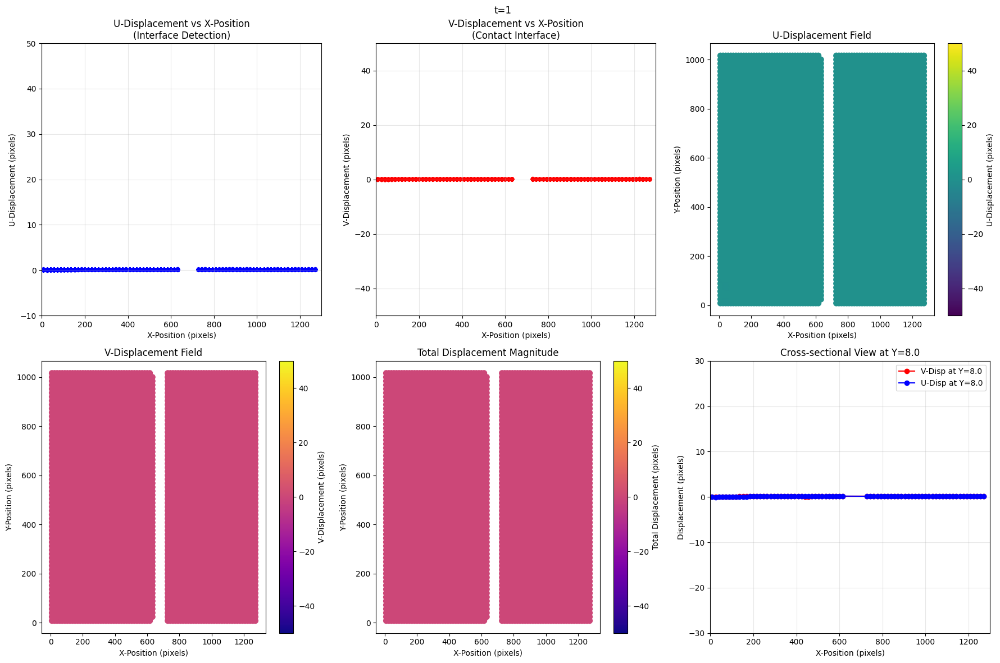

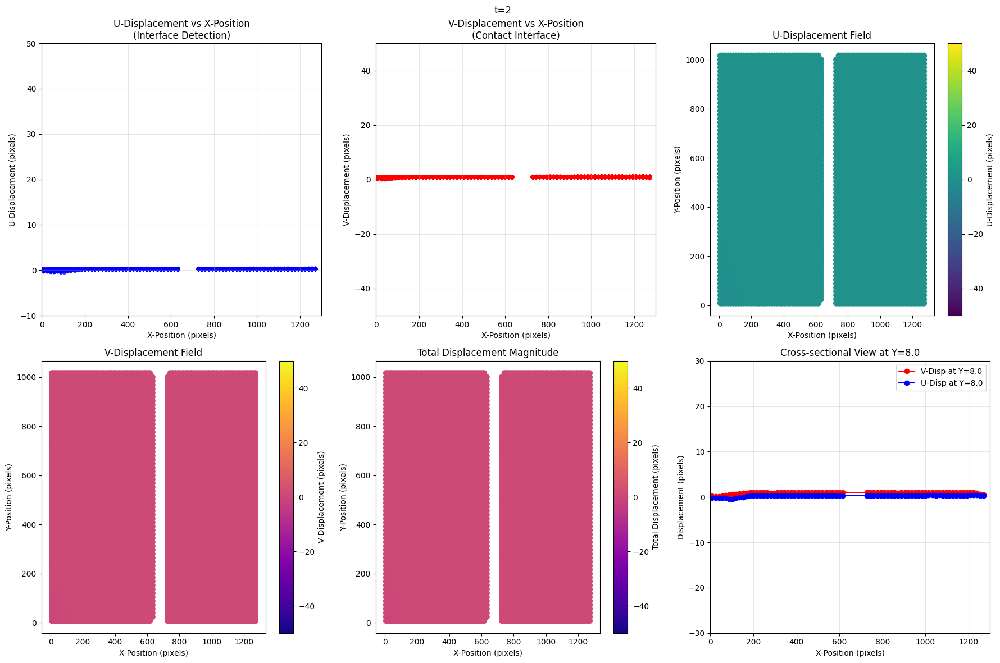

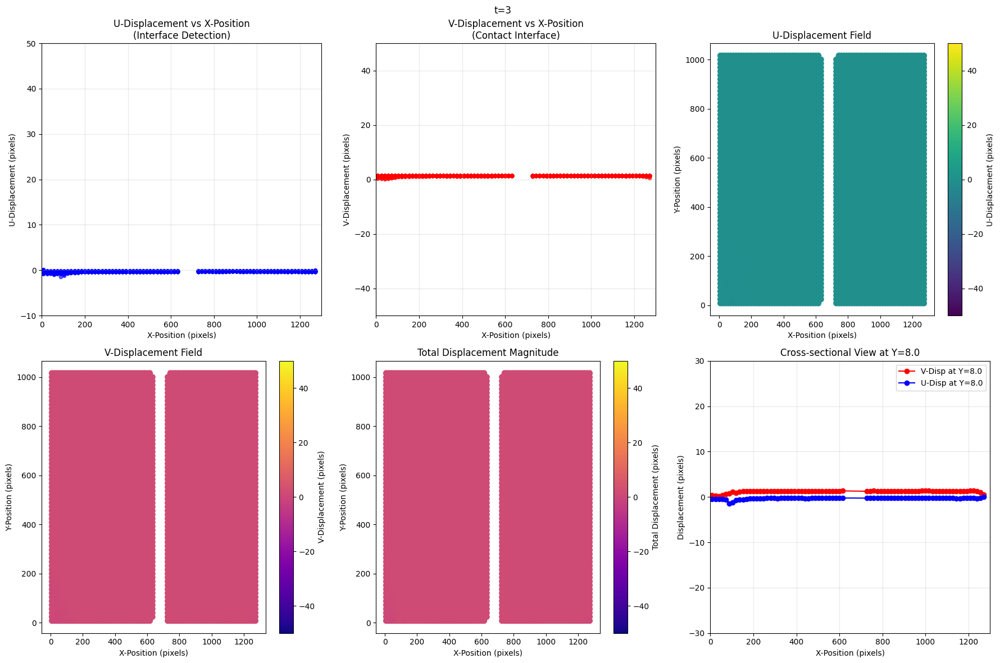

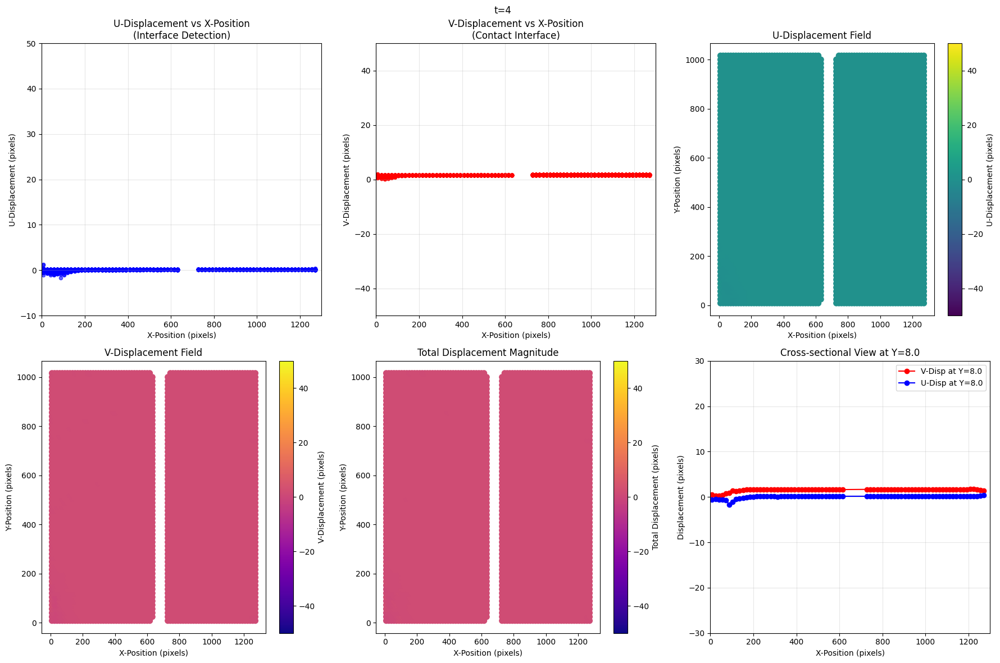

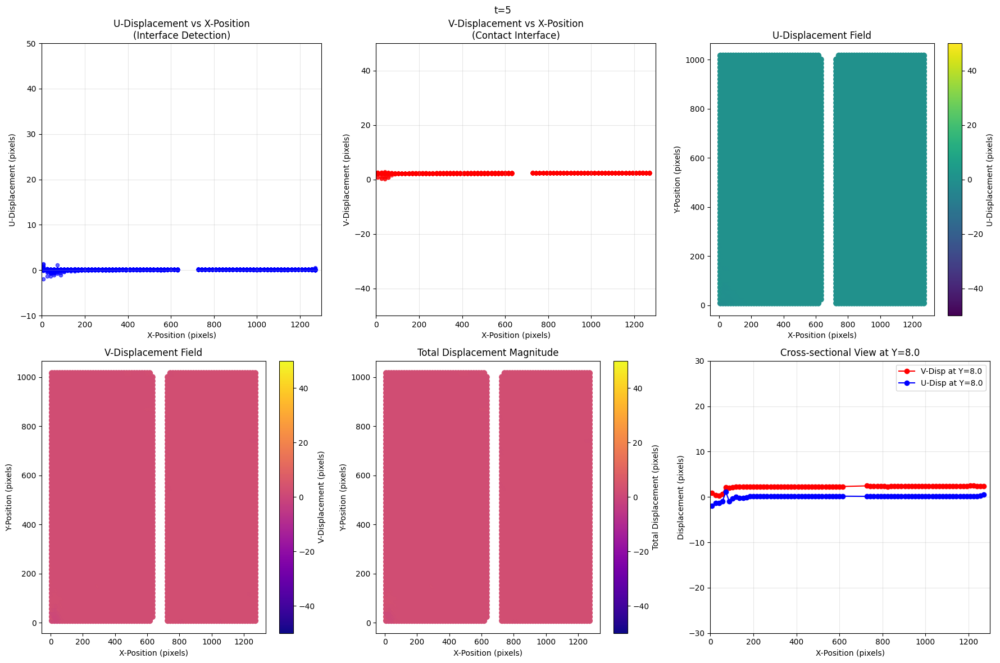

...

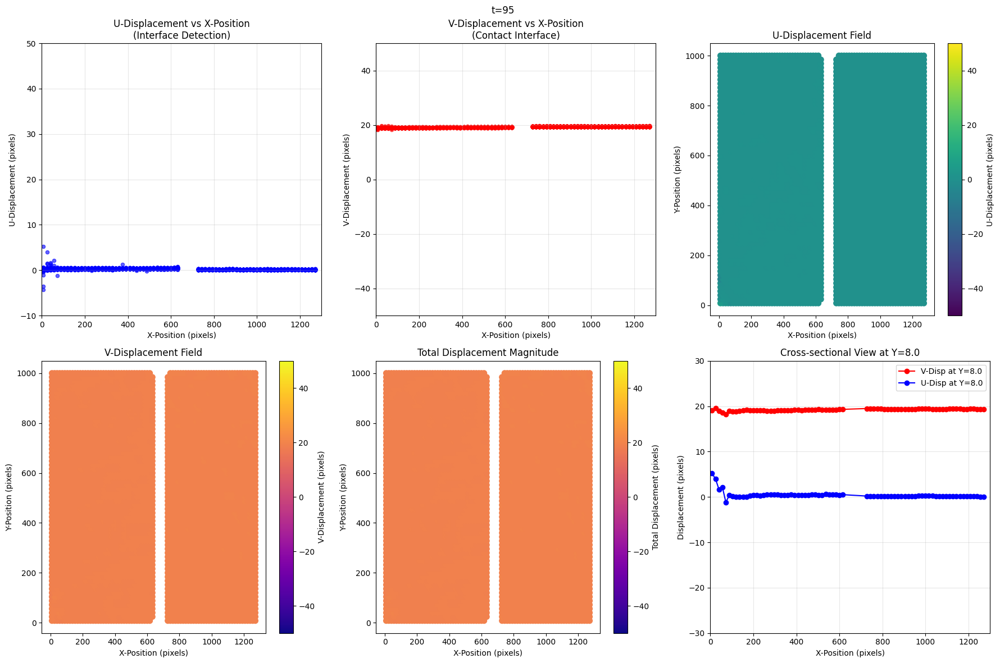

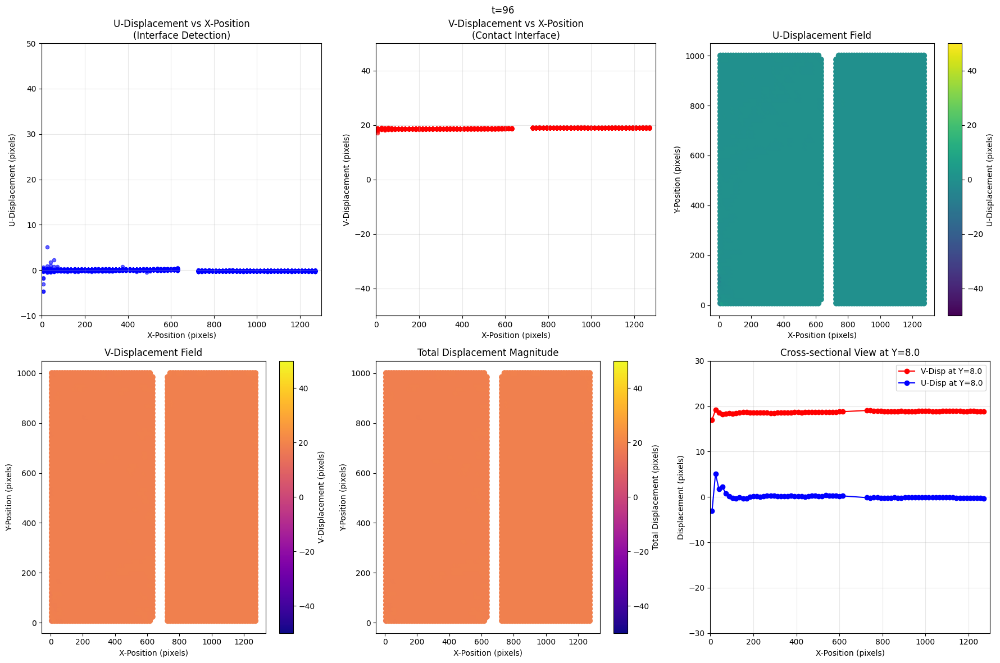

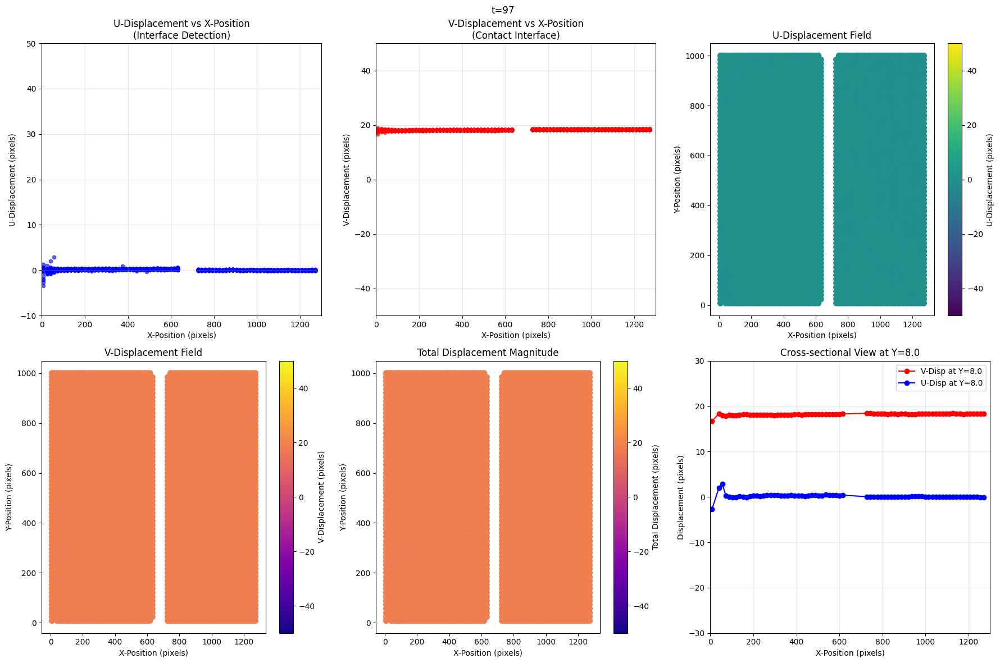

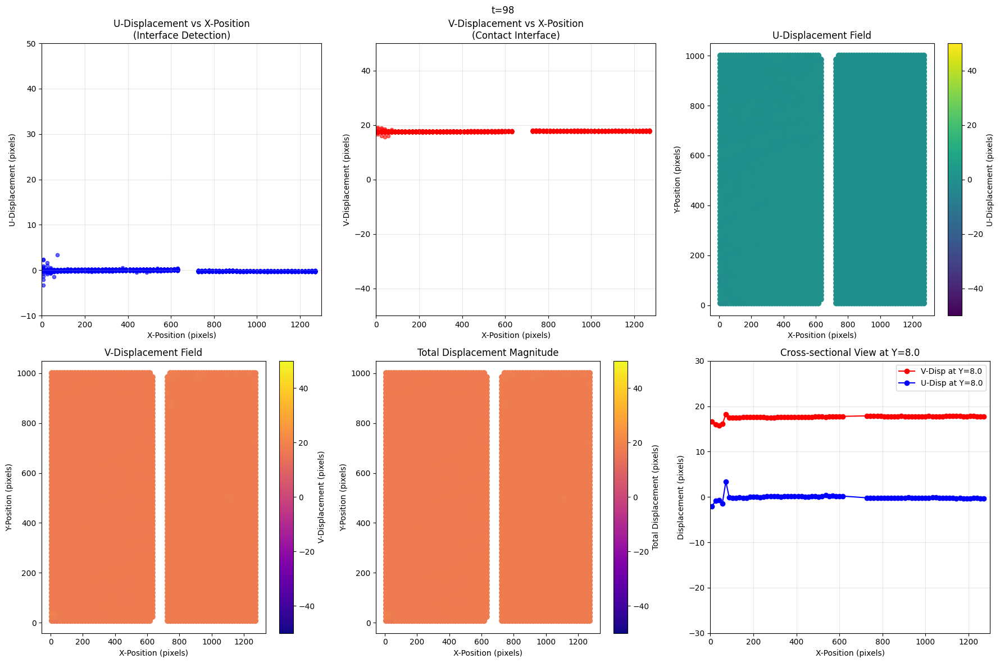

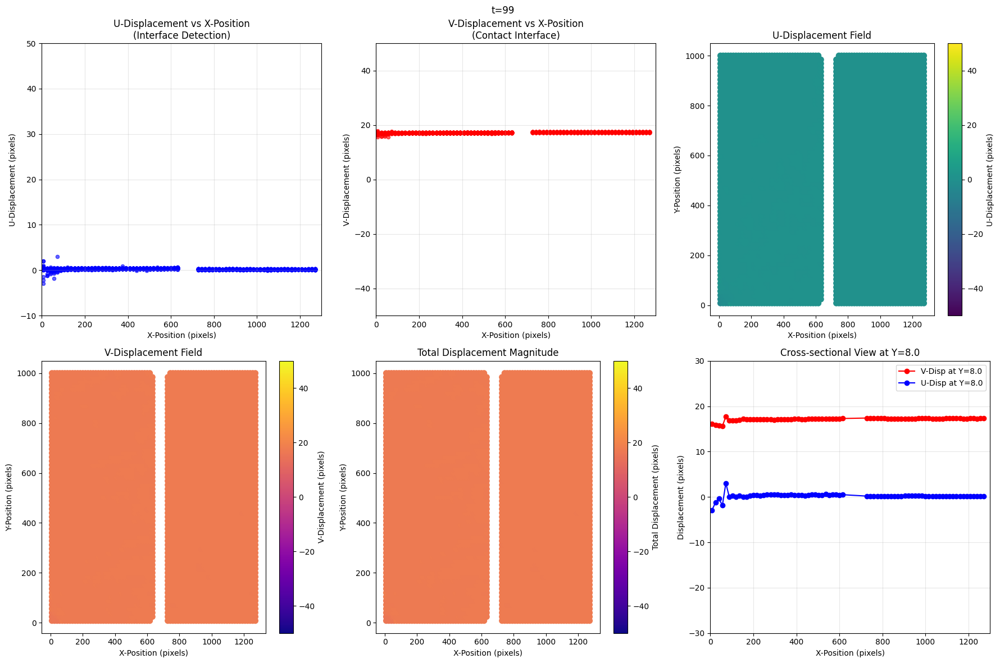

In [6]:
for i in range(1, 100+1): infer_plot(i, "Plots_per_timestep_Tangential_Loading", show=False)

In [9]:
def create_opencv_quicktime_video(image_folder, output_video, fps=2):
    """Create QuickTime-compatible video using OpenCV with proper numerical ordering"""
    
    # Method 1: Use natural sorting with custom key function
    def natural_sort_key(filename):
        """Extract number from filename for proper sorting"""
        import re
        # Extract numbers from filename (assumes format like "1.png", "2.png", etc.)
        numbers = re.findall(r'\d+', os.path.basename(filename))
        return int(numbers[0]) if numbers else 0
    
    # Get all PNG files and sort them numerically
    image_pattern = os.path.join(image_folder, "*.png")
    images = sorted(glob.glob(image_pattern), key=natural_sort_key)
    
    if not images:
        print("No images found!")
        return
    
    print(f"Found {len(images)} images")
    print("First few images in order:")
    for i, img in enumerate(images[:5]):
        print(f"  {i+1}: {os.path.basename(img)}")
    
    # Read first image to get dimensions
    first_image = cv2.imread(images[0])
    height, width, layers = first_image.shape
    
    # Use H.264 codec with proper settings
    fourcc = cv2.VideoWriter_fourcc(*'H264')
    
    # Create temporary AVI first, then convert to MP4
    temp_video = "temp_video.avi"
    video_writer = cv2.VideoWriter(temp_video, fourcc, fps, (width, height))
    
    print(f"Processing {len(images)} images in numerical order...")
    for i, image_path in enumerate(images):
        frame = cv2.imread(image_path)
        if frame is not None:
            video_writer.write(frame)
            if i % 5 == 0:  # Print progress every 5 images
                print(f"Progress: {i+1}/{len(images)} - {os.path.basename(image_path)}")
    
    video_writer.release()
    cv2.destroyAllWindows()
    
    # Convert to QuickTime-compatible MP4 using FFmpeg
    print("Converting to QuickTime-compatible format...")
    cmd = [
        'ffmpeg',
        '-i', temp_video,
        '-c:v', 'libx264',
        '-profile:v', 'main',
        '-pix_fmt', 'yuv420p',
        '-movflags', '+faststart',
        '-y',
        output_video
    ]
    
    try:
        subprocess.run(cmd, check=True, capture_output=True)
        os.remove(temp_video)  # Clean up temporary file
        print(f"✅ QuickTime-compatible video created: {output_video}")
    except subprocess.CalledProcessError as e:
        print(f"❌ Conversion failed: {e}")

# Usage
create_opencv_quicktime_video("Plots_per_timestep_Tangential_Loading", "DIC_opencv_Tangential_Loading.mp4", fps=1)

Found 99 images
First few images in order:
  1: 1.png
  2: 2.png
  3: 3.png
  4: 4.png
  5: 5.png
Processing 99 images in numerical order...
Progress: 1/99 - 1.png


[ WARN:0@1542.044] global cap_ffmpeg.cpp:198 write FFmpeg: Failed to write frame
[ WARN:0@1542.376] global cap_ffmpeg.cpp:198 write FFmpeg: Failed to write frame
[ WARN:0@1543.099] global cap_ffmpeg.cpp:198 write FFmpeg: Failed to write frame


Progress: 6/99 - 6.png
Progress: 11/99 - 11.png


[ WARN:0@1545.260] global cap_ffmpeg.cpp:198 write FFmpeg: Failed to write frame


Progress: 16/99 - 16.png
Progress: 21/99 - 21.png
Progress: 26/99 - 26.png


[ WARN:0@1552.730] global cap_ffmpeg.cpp:198 write FFmpeg: Failed to write frame


Progress: 31/99 - 31.png


[ WARN:0@1553.800] global cap_ffmpeg.cpp:198 write FFmpeg: Failed to write frame


Progress: 36/99 - 36.png


[ WARN:0@1554.893] global cap_ffmpeg.cpp:198 write FFmpeg: Failed to write frame
[ WARN:0@1555.602] global cap_ffmpeg.cpp:198 write FFmpeg: Failed to write frame
[ WARN:0@1556.337] global cap_ffmpeg.cpp:198 write FFmpeg: Failed to write frame


Progress: 41/99 - 41.png
Progress: 46/99 - 46.png
Progress: 51/99 - 51.png


[ WARN:0@1562.262] global cap_ffmpeg.cpp:198 write FFmpeg: Failed to write frame


Progress: 56/99 - 56.png
Progress: 61/99 - 61.png


[ WARN:0@1566.367] global cap_ffmpeg.cpp:198 write FFmpeg: Failed to write frame
[ WARN:0@1570.277] global cap_ffmpeg.cpp:198 write FFmpeg: Failed to write frame


Progress: 66/99 - 66.png
Progress: 71/99 - 71.png
Progress: 76/99 - 76.png


[ WARN:0@1590.528] global cap_ffmpeg.cpp:198 write FFmpeg: Failed to write frame
[ WARN:0@1592.517] global cap_ffmpeg.cpp:198 write FFmpeg: Failed to write frame
[ WARN:0@1593.556] global cap_ffmpeg.cpp:198 write FFmpeg: Failed to write frame


Progress: 81/99 - 81.png


[ WARN:0@1597.534] global cap_ffmpeg.cpp:198 write FFmpeg: Failed to write frame


Progress: 86/99 - 86.png
Progress: 91/99 - 91.png
Progress: 96/99 - 96.png
Converting to QuickTime-compatible format...
✅ QuickTime-compatible video created: DIC_opencv_Tangential_Loading.mp4


In [48]:
import os
import glob

def load_dic_file(filename):
    """Load single DIC file"""
    with open(filename, 'r') as f:
        content = f.readlines()
    
    df = pd.DataFrame([[float(j) for j in i.split("\t")] for i in content[1:]])
    df = df.rename({0: "X-Position", 1: "Y-Position", 2: "U-Displacement", 3: "V-Displacement"}, axis=1)
    return df

# Load all files in sequence
file_pattern = "DIC_Data/Normal/R1_CAFS13/R1_Loading_SumDiff/B*.txt"
file_list = sorted(glob.glob(file_pattern))

# Store all data
all_data = {}
for i, filename in enumerate(file_list):
    load_step = i + 1  # Load step number
    all_data[load_step] = load_dic_file(filename)
    print(f"Loaded {filename} as load step {load_step}")


Loaded DIC_Data/Normal/R1_CAFS13/R1_Loading_SumDiff/B00001.txt as load step 1
Loaded DIC_Data/Normal/R1_CAFS13/R1_Loading_SumDiff/B00002.txt as load step 2
Loaded DIC_Data/Normal/R1_CAFS13/R1_Loading_SumDiff/B00003.txt as load step 3
Loaded DIC_Data/Normal/R1_CAFS13/R1_Loading_SumDiff/B00004.txt as load step 4
Loaded DIC_Data/Normal/R1_CAFS13/R1_Loading_SumDiff/B00005.txt as load step 5
Loaded DIC_Data/Normal/R1_CAFS13/R1_Loading_SumDiff/B00006.txt as load step 6
Loaded DIC_Data/Normal/R1_CAFS13/R1_Loading_SumDiff/B00007.txt as load step 7
Loaded DIC_Data/Normal/R1_CAFS13/R1_Loading_SumDiff/B00008.txt as load step 8
Loaded DIC_Data/Normal/R1_CAFS13/R1_Loading_SumDiff/B00009.txt as load step 9
Loaded DIC_Data/Normal/R1_CAFS13/R1_Loading_SumDiff/B00010.txt as load step 10
Loaded DIC_Data/Normal/R1_CAFS13/R1_Loading_SumDiff/B00011.txt as load step 11
Loaded DIC_Data/Normal/R1_CAFS13/R1_Loading_SumDiff/B00012.txt as load step 12
Loaded DIC_Data/Normal/R1_CAFS13/R1_Loading_SumDiff/B00013.tx

In [51]:
all_data

{1:       X-Position  Y-Position  U-Displacement  V-Displacement
 0           16.0        16.0         18.6507       -0.308418
 1           48.0        16.0         18.2090       -0.602287
 2           80.0        16.0         14.1088       -1.770360
 3          112.0        16.0         13.8437       -1.979270
 4          144.0        16.0         13.9597       -2.043350
 ...          ...         ...             ...             ...
 1275      1136.0      1008.0         12.6465       -2.095250
 1276      1168.0      1008.0         12.6338       -2.081150
 1277      1200.0      1008.0         12.6341       -2.090960
 1278      1232.0      1008.0         12.6592       -2.078210
 1279      1264.0      1008.0          0.0000        0.000000
 
 [1280 rows x 4 columns],
 2:       X-Position  Y-Position  U-Displacement  V-Displacement
 0           16.0        16.0         35.4104       -0.515016
 1           48.0        16.0         34.5086       -1.826610
 2           80.0        16.0       